In [17]:
#!/usr/bin/env python3 
# -*- coding: utf-8 -*-
"""------------------------------------------------------------------------

Plotting of simulation results/noise thresholds - in grid format 
    - Try colour grids and quiver plots 

Author: Emma Thomson
Year: 2023
Institution: Centre for Medical Image Computing: University College London
Email: e.thomson.19@ucl.ac.uk
------------------------------------------------------------------------"""

''' -----------------------------PACKAGES--------------------------------- '''

import numpy as np

import glob
import os
import matplotlib.pyplot as plt

plt.rcParams['font.family'] = 'Times'
plt.rcParams['font.size'] = 55

import warnings
warnings.filterwarnings("ignore")

from palettable.colorbrewer.diverging import RdYlGn_6_r as colour
colourHold = colour.mpl_colormap 
colour_map = colourHold 

import time

t0 = time.time()

#go up a folder
os.chdir("..")


In [18]:


''' -----------------------------FUNCTIONS--------------------------------- '''


def sigmoid(x,L,k,x0): #m,c #L,k,x0
    func = 200*L/(1+np.exp(-k*(x-x0)))#+b
    #y = m*x+c
    return np.squeeze(func)

def find_nearest(yarray, xarray, value):
    array = np.asarray(yarray)
    idx=(np.abs(array-value)).argmin()
    return xarray[idx]


In [19]:

''' -----------------------------INPUTS--------------------------------- '''
#folder name
#unique_id = 'noisy_ISMRM_matching'


#noise levels 
noise = 2
#dictionary repeats 
repeats = 50
dimensionality = 7 #7 #5 #2

#range of noises for grid plots
noise_range = [0.00, 0.0196]

maptype = 'quiver' #'quantitative'

#number of isochromats dictionary is created with 
#need to sqrt
iso = np.sqrt(10000)

patternMatchingPath = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/' #'./Dictionaries/simulationMatching/Matching_'


In [20]:

''' -----------------------------SET LIMITS--------------------------------- '''

if dimensionality == 5: 
    #dimensionality of each dictionary dimension
    x1 = 6 #6 #T1t #6
    x2 = 3 #3 #T1b #3
    x3 = 15 #res
    x4 = 10 #perc
    x5 = 5 #5 #multi #5
elif dimensionality == 7:
    #dimensionality of each dictionary dimension
    x1 = 6 #T1t #6
    x2 = 3 #T1b #3
    x3 = 6 #T2t #6
    x4 = 3 #T2b #3
    x5 = 15 #res
    x6 = 10 #perc
    x7 = 5 #5 #multi #5
else: 
    #dimensionality of each dictionary dimension
    x1 = 1 #T1t #6
    x2 = 1 #T1b #3
    x3 = 15 #res
    x4 = 10 #perc
    x5 = 1 #multi #5
    
#what percentages do you want to consider
percentages = np.array([range(0,10)])

#limit of successful matching 
limit_blood = 1
limit_res = 100


In [21]:

''' -----------------------------READ IN FISP--------------------------------- '''

#empty arrays 
array_mean = np.zeros((x1,x2,x3,x4,x5,x6,x7,7,noise)) # (T1t, T1b, T2t, T2b, res, perc, multi, dims?, noise)
array_err = np.zeros((x1,x2,x3,x4,x5,x6,x7,7,noise))
files = []

if dimensionality == 7:
    mean_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise]) # vb
    std_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise])
    mean_rep_array_res = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise]) # tau
    std_rep_array_res = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise])

mean_rep_array_blood = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_blood = np.zeros([x5,x6,noise])
mean_rep_array_res = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_res = np.zeros([x5,x6,noise])
mean_rep_array_t1b = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1b = np.zeros([x5,x6,noise])
mean_rep_array_t1t = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1t = np.zeros([x5,x6,noise])
mean_rep_array_b1 = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_b1 = np.zeros([x5,x6,noise])
mean_rep_array_t2b = np.zeros([x5,x6,noise])
std_rep_array_t2b = np.zeros([x5,x6,noise])
mean_rep_array_t2t = np.zeros([x5,x6,noise])
std_rep_array_t2t = np.zeros([x5,x6,noise])



In [22]:
np.shape(mean_rep_array_blood[:,:,0])
np.mean(mean_rep_array_blood[:,:,0])

0.0

In [23]:
res = 1600
perc = 10
base_folder = patternMatchingPath +'/noisy_upgradeFISPNoB1_matching/'
search_pattern = f"{base_folder}/*_*_*_*_{res}_{int(perc*10)}_*_pc.npy"

# Find all files that match the search pattern
matching_files = glob.glob(search_pattern)
matching_files


['/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1400_1500_38_165_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1400_1500_53_55_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1400_1500_53_165_1600_100_1.1_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1600_1900_112_165_1600_100_1.2_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1800_1700_112_275_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1200_1700_53_55_1600_100_1.0_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching/1800_1900_83_165_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgradeFISPNoB1_matching

In [8]:
test = np.load('/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1000_1500_38_55_1200_20_0.8_pc.npy')
print(test)

[[[1.00e+03 1.50e+03 3.80e+01 5.50e+01 1.20e+03 2.00e+00 8.00e-01]
  [1.00e+03 1.70e+03 5.30e+01 1.65e+02 1.20e+03 1.00e+00 8.00e-01]]

 [[0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
  [0.00e+00 2.00e+02 1.50e+01 2.20e+02 5.00e+02 1.00e+00 0.00e+00]]]


/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/2000_1500_98_165_200_10_1.1_pc.npy
[[200.   1.]
 [300.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1000_1700_68_165_200_10_0.8_pc.npy
[[200.   1.]
 [700.   2.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1400_1900_68_165_200_10_0.8_pc.npy
[[200.   1.]
 [800.   2.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/2000_1500_98_55_200_10_1.2_pc.npy
[[200.   1.]
 [400.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1400_1900_53_275_200_10_1.0_pc.npy
[[200.   1.]
 [200.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1000_1500_38_55_200_10_0.8_pc.npy
[[ 200.    1.]
 [1000.    2.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1400_1500_

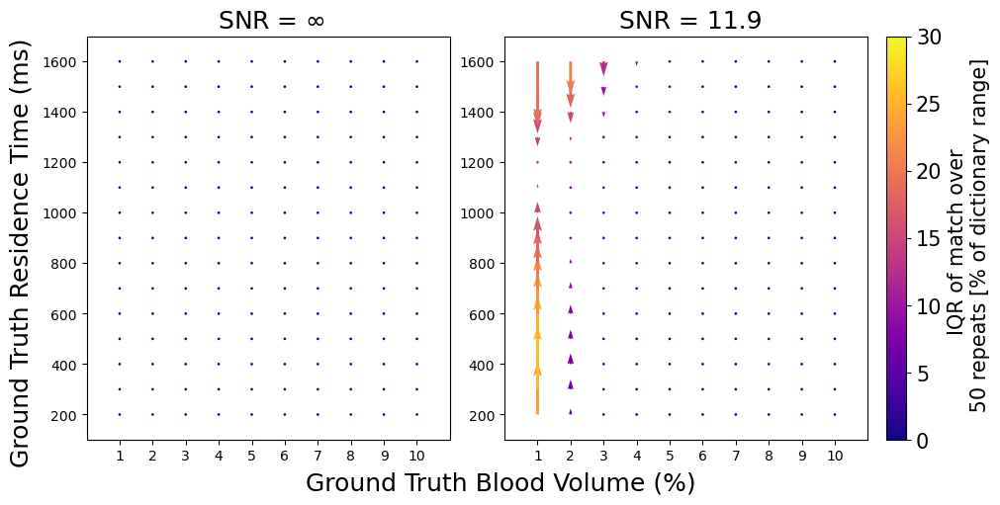

In [59]:
# FOR FISP#
import glob
import os
import numpy as np
import itertools
import matplotlib.pyplot as plt

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching'
# Creating grid of residence time and blood volume values
X = np.arange(1, 11, 1)
Y = np.arange(200, 1700, 100)
#X, Y = np.meshgrid(xx, yy)

permutations = list(itertools.product(X, Y))

noi = 2

noise_plot = 0.196

#Arrow specifics
wid = 0.008
sca = 5

# Reset to default font
plt.rcdefaults()

fig, ax = plt.subplots(1, 2, constrained_layout=True)
fig.set_size_inches(10, 5, forward=True)
plt.rcParams.update({'font.size': 15})
plt.rcParams['xtick.labelsize'] = 15
plt.rcParams['ytick.labelsize'] = 15
ax[0].set_ylim([100, 1700])
ax[0].set_xlim([0, 11])
ax[0].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[0].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks
ax[1].set_ylim([100, 1700])
ax[1].set_xlim([0, 11])
ax[1].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[1].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks

fig.supylabel('Ground Truth Residence Time (ms)')
fig.supxlabel('Ground Truth Blood Volume (%)')

cstore = []

#mean_match = np.zeros(X.shape + (noi,))
#iqr_match = np.zeros(X.shape + (noi,))
for perm in permutations:
    perc = perm[0]
    res = perm[1]
    #print(f"X = {perc}, Y = {res}")
    # in the folder, find all files that match the current search for vb and residence time
    # Construct the search pattern
    search_pattern = f"{base_folder}/*_*_*_*_{res}_{int(perc*10)}_*_pc.npy"

    # Find all files that match the search pattern
    matching_files = glob.glob(search_pattern)
    num_permutations = len(matching_files)
    matched_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    iqr_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    file_c = 0
    for file in matching_files:
        print(file)
        current_match = np.load(file)
        matched_values = current_match[0, :, 4:6]  # select the match to the query (res time, bv are at 4 and 5)
        print(matched_values)
        iqr_values = current_match[1, :, 4:6]
        matched_values_all_files[file_c, :, :] = matched_values
        iqr_values_all_files[file_c, :, :] = iqr_values
        file_c += 1
    mean_matched_values = np.mean(matched_values_all_files, axis=0)
    mean_iqr_values = np.mean(iqr_values_all_files, axis=0)

    # make quiver plot
    for n in range(noi):
        # Find the nearest value in the array
        #u_nearest_value = min(X, key=lambda x: abs(x - np.rint(mean_matched_values[n, 1])))
        #v_nearest_value = min(Y, key=lambda x: abs(x - np.rint(mean_matched_values[n, 0])))
        u = np.rint(mean_matched_values[n, 1]) - perc  # bv
        v = np.rint(mean_matched_values[n, 0]) -res  # tau
        u_iqr = mean_iqr_values[n, 1]
        v_iqr = mean_iqr_values[n, 0]

        color = (v_iqr / 1500 + u_iqr / 10) / 2 * 100
        cstore.append(color)

        Q = ax[n].quiver(perc, res, u, v, color, width=wid, angles='xy',
                         scale_units='xy', scale=1, cmap='plasma')
        Q.set_clim(0, 30)

        if n == 1:
            ax[n].set_title(' SNR = ' + str(11.9))
        else:
            ax[n].set_title(r' SNR = $\infty$')

cbar = plt.colorbar(Q, label='IQR of match over \n 50 repeats [% of dictionary range]')
plt.show()
    

In [61]:
np.max(cstore)

25.66137566137566

In [10]:
matched_values
a = np.mean(matched_values_all_files, axis=0)
a[0,1]

10.0

# Error Of Each Parameter Match at Each Noise Level

In [33]:
import numpy as np
import glob

def parameter_mean_iqr(groundTruths, file_query, noi, param_pos):
    # param_pos: 0 = T1t, 1 = T2b, 2 = T2t, 3 = T2b, 4 = res, 5 = bv, 6 = B1
    allmean_values = np.zeros((np.shape(groundTruths)[0], noi))
    alliqr_values = np.zeros((np.shape(groundTruths)[0], noi))
    print('Ground Truths:' + str(groundTruths))

    param = 0
    for value in groundTruths:
        # Construct the search pattern
        search_pattern = file_query.format(value)

        # Find all files that match the search pattern
        matching_files = glob.glob(search_pattern)
        num_files= len(matching_files)
        matched_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        iqr_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        file_c = 0
        for file in matching_files:
            current_match = np.load(file)
            matched_values = current_match[0, :, param_pos]  
            iqr_values = current_match[1, :, param_pos]
            matched_values_all_files[file_c, :] = matched_values
            iqr_values_all_files[file_c, :] = iqr_values
            file_c += 1
        mean_matched_values = np.mean(matched_values_all_files, axis=0)
        mean_iqr_values = np.mean(iqr_values_all_files, axis=0)
        allmean_values[param, :] = mean_matched_values
        alliqr_values[param, :] = mean_iqr_values

        param += 1

    return allmean_values, alliqr_values



In [26]:
import glob
import os
import numpy as np
import itertools

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching'

# ground truth parameter values

resArray = np.arange(200,1700,100) #range(200,1700,107) #range(200,1700,70) 
# percentage blood volume (perc) UNIT: %
percArray = np.arange(10,110,10) #REMEMBER IT WILL BE DIVIDED BY 10 110
#T1 of tissue compartment (t1t) UNIT: ms
t1tArray = np.arange(1000,2200,200) #range(700,1700,69) 
#T1 of blood compartment (t1b) UNIT: ms
t1bArray = np.arange(1500,2100,200) #range(1540,1940,27) 
# multiplication factor for the B1 value (multi)
multiArray = np.arange(80, 130, 10) #100
# T2 of tissue compartment UNIT: ms
t2tArray = np.arange(38,127,15)
# T2 of blood compartment UNIT: ms
t2bArray = np.arange(55, 385, 110)
if t2tArray[-1] > 112:
    t2tArray= list(t2tArray)
    t2tArray[-1] = 112

noi = 2




In [27]:
test_match = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1000_1500_38_55_200_10_0.8_pc.npy'
fisp_fipri_match= np.load(test_match)
fisp_fipri_match.shape

(2, 2, 7)

### Find the mean matched values

In [31]:
base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching'
resfile_query = base_folder+"/*_*_*_*_{}_*_*_pc.npy"
resmean_matched_values, resmean_iqr_values = parameter_mean_iqr(resArray, resfile_query, noi, param_pos = 4)

Ground Truths:[ 200  300  400  500  600  700  800  900 1000 1100 1200 1300 1400 1500
 1600]
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600


array([[ 200.        ,  223.34920635],
       [ 300.        ,  329.14285714],
       [ 400.        ,  431.52380952],
       [ 500.        ,  529.96825397],
       [ 600.        ,  626.55555556],
       [ 700.        ,  720.38095238],
       [ 800.        ,  815.06349206],
       [ 900.        ,  909.49206349],
       [1000.        , 1004.57142857],
       [1100.        , 1101.3015873 ],
       [1200.        , 1198.25396825],
       [1300.        , 1293.46031746],
       [1400.        , 1384.33333333],
       [1500.        , 1470.61904762],
       [1600.        , 1553.73015873]])

In [32]:
t1tfile_query = base_folder+"/{}_*_*_*_*_*_*_pc.npy"
t1tmean_matched_values, t1tmean_iqr_values = parameter_mean_iqr(t1tArray, t1tfile_query, noi, param_pos = 0)

t1bfile_query = base_folder+"/*_{}_*_*_*_*_*_pc.npy"
t1bmean_matched_values, t1bmean_iqr_values = parameter_mean_iqr(t1bArray, t1bfile_query, noi, param_pos = 1)

t2tfile_query = base_folder+"/*_*_{}_*_*_*_*_pc.npy"
t2tmean_matched_values, t2tmean_iqr_values = parameter_mean_iqr(t2tArray, t2tfile_query, noi, param_pos = 2)

t2bfile_query = base_folder+"/*_*_*_{}_*_*_*_pc.npy"
t2bmean_matched_values, t2bmean_iqr_values = parameter_mean_iqr(t2bArray, t2bfile_query, noi, param_pos = 3)

percfile_query = base_folder+"/*_*_*_*_*_{}_*_pc.npy"
percmean_matched_values, percmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 5)

multfile_query = base_folder+"/*_*_*_*_*_*_{}_pc.npy"
multmean_matched_values, multmean_iqr_values = parameter_mean_iqr(multiArray/100, multfile_query, noi, param_pos = 6)

Ground Truths:[1000 1200 1400 1600 1800 2000]
1000
1200


KeyboardInterrupt: 

In [34]:
percfile_query = base_folder+"/*_*_*_*_*_{}_*_pc.npy"
percmean_matched_values, percmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 5)

Ground Truths:[ 10  20  30  40  50  60  70  80  90 100]


Mean Percentage Error for each column: [ 0.         -0.22688335]


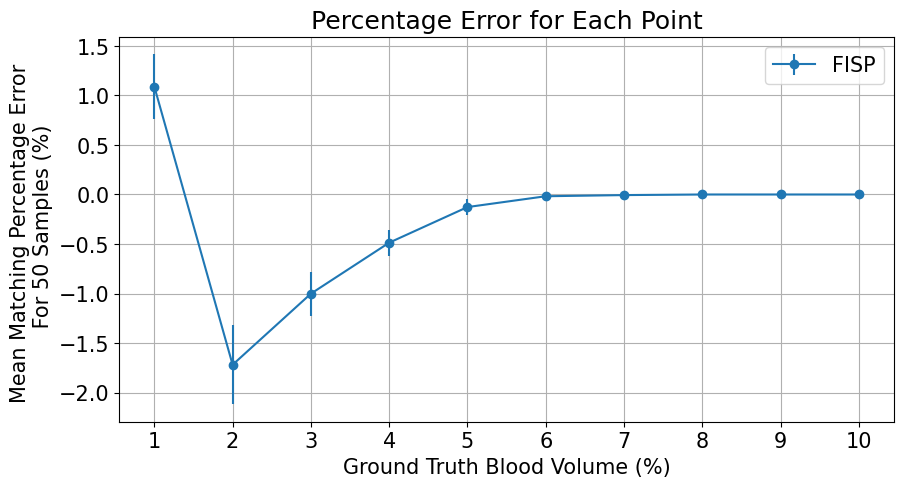

In [65]:
import numpy as np
import matplotlib.pyplot as plt

# Example ground truth array
ground_truths = percArray/10


# Ensure the arrays have the same number of rows
assert ground_truths.shape[0] == percmean_matched_values.shape[0], "Ground truth and test values must have the same number of rows"

# Reshape ground_truths to match the shape of percmean_matched_values
ground_truths = ground_truths[:, np.newaxis]

# Calculate the percentage error for each element
FISP_percentage_errors = ((percmean_matched_values - ground_truths) / ground_truths) * 100


# Calculate the mean percentage error for each column
FISP_mean_percentage_error = np.mean(FISP_percentage_errors, axis=0)

print("Mean Percentage Error for each column:", FISP_mean_percentage_error)

# Plot the percentage error for each of the 10 points
plt.figure(figsize=(10, 5))
plt.errorbar(ground_truths, FISP_percentage_errors[:, 1],yerr=percmean_iqr_values[:, 1], label='FISP', marker='o')
plt.xlabel('Ground Truth Blood Volume (%)')
plt.ylabel('Mean Matching Percentage Error \n For 50 Samples (%)')
plt.title('Percentage Error for Each Point')
plt.legend()
plt.xticks([1,2,3,4,5,6,7,8,9,10])
plt.grid(True)

plt.show()

In [50]:
percmean_iqr_values


array([[0.        , 0.32687831],
       [0.        , 0.39873016],
       [0.        , 0.22253968],
       [0.        , 0.13312169],
       [0.        , 0.0815873 ],
       [0.        , 0.04486772],
       [0.        , 0.01703704],
       [0.        , 0.0042328 ],
       [0.        , 0.00126984],
       [0.        , 0.        ]])

In [15]:
def calculate_PME(ground_truths, test_values):
    test_values = np.squeeze(test_values)
    ground_truths = np.array(ground_truths)
    # Ensure the arrays have the same shape
    assert ground_truths.shape[0] == test_values.shape[0], "Ground truth and test values must have the same number of rows"
    # Reshape ground_truths to match the shape of resmean_matched_values
    ground_truths = ground_truths[:, np.newaxis]

    # Calculate the percentage error for each element
    percentage_errors = (np.abs((test_values - ground_truths)) / ground_truths) * 100

    # Calculate the mean percentage error
    mean_percentage_error = np.mean(percentage_errors, axis=0)

    print("Mean Percentage Error:", mean_percentage_error)

    return mean_percentage_error




In [16]:
print('T1t: clean, noise')
discard = calculate_PME(t1tArray, t1tmean_matched_values)
print('T1b: clean, noise')
discard = calculate_PME(t1bArray, t1bmean_matched_values)
print('T2t: clean, noise')
discard = calculate_PME(t2tArray, t2tmean_matched_values)
print('T2b: clean, noise')
discard = calculate_PME(t2bArray, t2bmean_matched_values)
print('perc: clean, noise')
discard = calculate_PME(percArray/10, percmean_matched_values)
print('res: clean, noise')
discard = calculate_PME(resArray, resmean_matched_values)
print('B1: clean, noise')
discard = calculate_PME(multiArray/100, multmean_matched_values)

T1t: clean, noise
Mean Percentage Error: [0. 0.]
T1b: clean, noise
Mean Percentage Error: [0.        0.6726619]
T2t: clean, noise
Mean Percentage Error: [0.         0.45258336]
T2b: clean, noise
Mean Percentage Error: [0.         7.23017833]
perc: clean, noise
Mean Percentage Error: [0.         0.44487276]
res: clean, noise
Mean Percentage Error: [0.         3.51548399]
B1: clean, noise
Mean Percentage Error: [1.98108365e-11 1.98108365e-11]


# FISP B1 PLOTTING AND STATS

In [ ]:

''' -----------------------------INPUTS--------------------------------- '''
#folder name
#unique_id = 'noisy_ISMRM_matching'


#noise levels 
noise = 2
#dictionary repeats 
repeats = 50
dimensionality = 7 #7 #5 #2

#range of noises for grid plots
noise_range = [0.00, 0.0196]

maptype = 'quiver' #'quantitative'

#number of isochromats dictionary is created with 
#need to sqrt
iso = np.sqrt(10000)

patternMatchingPath = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/' #'./Dictionaries/simulationMatching/Matching_'


In [ ]:

''' -----------------------------SET LIMITS--------------------------------- '''

if dimensionality == 5: 
    #dimensionality of each dictionary dimension
    x1 = 6 #6 #T1t #6
    x2 = 3 #3 #T1b #3
    x3 = 15 #res
    x4 = 10 #perc
    x5 = 5 #5 #multi #5
elif dimensionality == 7:
    #dimensionality of each dictionary dimension
    x1 = 6 #T1t #6
    x2 = 3 #T1b #3
    x3 = 6 #T2t #6
    x4 = 3 #T2b #3
    x5 = 15 #res
    x6 = 10 #perc
    x7 = 5 #5 #multi #5
else: 
    #dimensionality of each dictionary dimension
    x1 = 1 #T1t #6
    x2 = 1 #T1b #3
    x3 = 15 #res
    x4 = 10 #perc
    x5 = 1 #multi #5
    
#what percentages do you want to consider
percentages = np.array([range(0,10)])

#limit of successful matching 
limit_blood = 1
limit_res = 100


In [ ]:

''' -----------------------------READ IN FISP--------------------------------- '''

#empty arrays 
array_mean = np.zeros((x1,x2,x3,x4,x5,x6,x7,7,noise)) # (T1t, T1b, T2t, T2b, res, perc, multi, dims?, noise)
array_err = np.zeros((x1,x2,x3,x4,x5,x6,x7,7,noise))
files = []

if dimensionality == 7:
    mean_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise]) # vb
    std_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise])
    mean_rep_array_res = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise]) # tau
    std_rep_array_res = np.zeros([x1,x2,x3,x4,x5,x6, x7,noise])

mean_rep_array_blood = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_blood = np.zeros([x5,x6,noise])
mean_rep_array_res = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_res = np.zeros([x5,x6,noise])
mean_rep_array_t1b = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1b = np.zeros([x5,x6,noise])
mean_rep_array_t1t = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1t = np.zeros([x5,x6,noise])
mean_rep_array_b1 = np.zeros([x5,x6,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_b1 = np.zeros([x5,x6,noise])
mean_rep_array_t2b = np.zeros([x5,x6,noise])
std_rep_array_t2b = np.zeros([x5,x6,noise])
mean_rep_array_t2t = np.zeros([x5,x6,noise])
std_rep_array_t2t = np.zeros([x5,x6,noise])



In [ ]:
np.shape(mean_rep_array_blood[:,:,0])
np.mean(mean_rep_array_blood[:,:,0])

0.0

In [63]:
res = 1600
perc = 10
base_folder = patternMatchingPath +'/noisy_upgrade_FISP_matching/'
search_pattern = f"{base_folder}/*_*_*_*_{res}_{int(perc*10)}_*_pc.npy"

# Find all files that match the search pattern
matching_files = glob.glob(search_pattern)
matching_files


['/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1400_1500_38_165_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1400_1500_53_55_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1400_1500_53_165_1600_100_1.1_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1600_1900_112_165_1600_100_1.2_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1800_1700_112_275_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1200_1700_53_55_1600_100_1.0_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1800_1900_83_165_1600_100_0.8_pc.npy',
 '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData//noisy_upgrade_FISP_matching/1600_1500_98_165_1600_1

In [64]:
test = np.load('/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching/1000_1500_38_55_1200_20_0.8_pc.npy')
print(test)

[[[1.00e+03 1.50e+03 3.80e+01 5.50e+01 1.20e+03 2.00e+00 8.00e-01]
  [1.00e+03 1.70e+03 5.30e+01 1.65e+02 1.20e+03 1.00e+00 8.00e-01]]

 [[0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00 0.00e+00]
  [0.00e+00 2.00e+02 1.50e+01 2.20e+02 5.00e+02 1.00e+00 0.00e+00]]]


/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/2000_1500_98_165_200_10_1.1_pc.npy
[[200.   1.]
 [200.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1000_1700_68_165_200_10_0.8_pc.npy
[[200.   1.]
 [700.   2.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1400_1900_68_165_200_10_0.8_pc.npy
[[200.   1.]
 [600.   2.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/2000_1500_98_55_200_10_1.2_pc.npy
[[200.   1.]
 [200.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1400_1900_53_275_200_10_1.0_pc.npy
[[200.   1.]
 [200.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1000_1500_38_55_200_10_0.8_pc.npy
[[200.   1.]
 [900.   1.]]
/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1400_1500_68_165_200_10_0.8_pc.npy


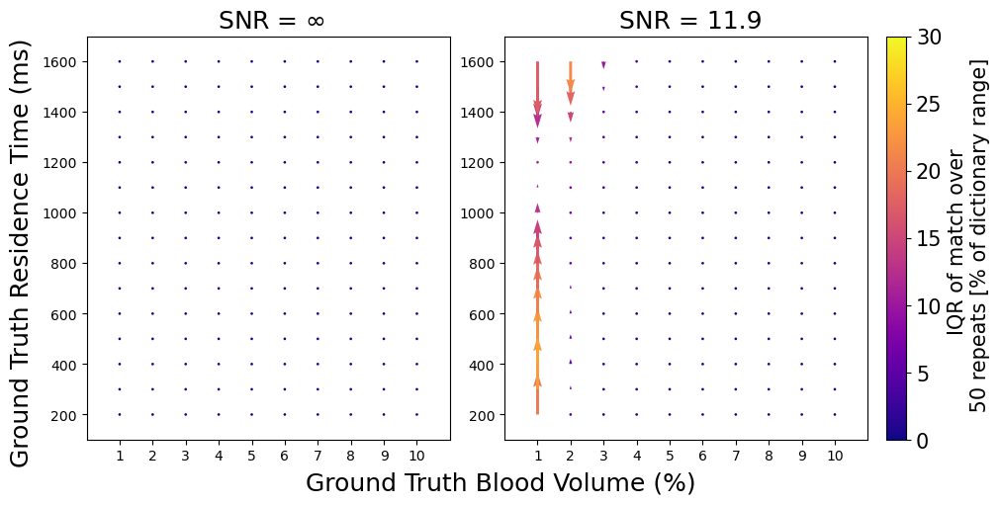

In [66]:
# FOR FISP#
import glob
import os
import numpy as np
import itertools
import matplotlib.pyplot as plt

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching'
# Creating grid of residence time and blood volume values
X = np.arange(1, 11, 1)
Y = np.arange(200, 1700, 100)
#X, Y = np.meshgrid(xx, yy)

permutations = list(itertools.product(X, Y))

noi = 2

noise_plot = 0.196

#Arrow specifics
wid = 0.008
sca = 5

# Reset to default font
plt.rcdefaults()

fig, ax = plt.subplots(1, 2, constrained_layout=True)
fig.set_size_inches(10, 5, forward=True)
plt.rcParams.update({'font.size': 15})
plt.rcParams['xtick.labelsize'] = 15
plt.rcParams['ytick.labelsize'] = 15
ax[0].set_ylim([100, 1700])
ax[0].set_xlim([0, 11])
ax[0].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[0].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks
ax[1].set_ylim([100, 1700])
ax[1].set_xlim([0, 11])
ax[1].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[1].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks

fig.supylabel('Ground Truth Residence Time (ms)')
fig.supxlabel('Ground Truth Blood Volume (%)')

cstore = []

#mean_match = np.zeros(X.shape + (noi,))
#iqr_match = np.zeros(X.shape + (noi,))
for perm in permutations:
    perc = perm[0]
    res = perm[1]
    #print(f"X = {perc}, Y = {res}")
    # in the folder, find all files that match the current search for vb and residence time
    # Construct the search pattern
    search_pattern = f"{base_folder}/*_*_*_*_{res}_{int(perc*10)}_*_pc.npy"

    # Find all files that match the search pattern
    matching_files = glob.glob(search_pattern)
    num_permutations = len(matching_files)
    matched_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    iqr_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    file_c = 0
    for file in matching_files:
        print(file)
        current_match = np.load(file)
        matched_values = current_match[0, :, 4:6]  # select the match to the query (res time, bv are at 4 and 5)
        print(matched_values)
        iqr_values = current_match[1, :, 4:6]
        matched_values_all_files[file_c, :, :] = matched_values
        iqr_values_all_files[file_c, :, :] = iqr_values
        file_c += 1
    mean_matched_values = np.mean(matched_values_all_files, axis=0)
    mean_iqr_values = np.mean(iqr_values_all_files, axis=0)

    # make quiver plot
    for n in range(noi):
        # Find the nearest value in the array
        #u_nearest_value = min(X, key=lambda x: abs(x - np.rint(mean_matched_values[n, 1])))
        #v_nearest_value = min(Y, key=lambda x: abs(x - np.rint(mean_matched_values[n, 0])))
        u = np.rint(mean_matched_values[n, 1]) - perc  # bv
        v = np.rint(mean_matched_values[n, 0]) -res  # tau
        u_iqr = mean_iqr_values[n, 1]
        v_iqr = mean_iqr_values[n, 0]

        color = (v_iqr / 1500 + u_iqr / 10) / 2 * 100
        cstore.append(color)

        Q = ax[n].quiver(perc, res, u, v, color, width=wid, angles='xy',
                         scale_units='xy', scale=1, cmap='plasma')
        Q.set_clim(0, 30)

        if n == 1:
            ax[n].set_title(' SNR = ' + str(11.9))
        else:
            ax[n].set_title(r' SNR = $\infty$')

cbar = plt.colorbar(Q, label='IQR of match over \n 50 repeats [% of dictionary range]')
plt.show()
    

In [67]:
np.max(cstore)

23.65079365079365

In [ ]:
matched_values
a = np.mean(matched_values_all_files, axis=0)
a[0,1]

10.0

In [68]:
import numpy as np
import glob

def parameter_mean_iqr(groundTruths, file_query, noi, param_pos):
    # param_pos: 0 = T1t, 1 = T2b, 2 = T2t, 3 = T2b, 4 = res, 5 = bv, 6 = B1
    allmean_values = np.zeros((np.shape(groundTruths)[0], noi))
    alliqr_values = np.zeros((np.shape(groundTruths)[0], noi))
    print('Ground Truths:' + str(groundTruths))

    param = 0
    for value in groundTruths:
        # Construct the search pattern
        search_pattern = file_query.format(value)

        # Find all files that match the search pattern
        matching_files = glob.glob(search_pattern)
        num_files= len(matching_files)
        matched_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        iqr_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        file_c = 0
        for file in matching_files:
            current_match = np.load(file)
            matched_values = current_match[0, :, param_pos]  
            iqr_values = current_match[1, :, param_pos]
            matched_values_all_files[file_c, :] = matched_values
            iqr_values_all_files[file_c, :] = iqr_values
            file_c += 1
        mean_matched_values = np.mean(matched_values_all_files, axis=0)
        mean_iqr_values = np.mean(iqr_values_all_files, axis=0)
        allmean_values[param, :] = mean_matched_values
        alliqr_values[param, :] = mean_iqr_values

        param += 1

    return allmean_values, alliqr_values



In [ ]:
import glob
import os
import numpy as np
import itertools

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching'

# ground truth parameter values

resArray = np.arange(200,1700,100) #range(200,1700,107) #range(200,1700,70) 
# percentage blood volume (perc) UNIT: %
percArray = np.arange(10,110,10) #REMEMBER IT WILL BE DIVIDED BY 10 110
#T1 of tissue compartment (t1t) UNIT: ms
t1tArray = np.arange(1000,2200,200) #range(700,1700,69) 
#T1 of blood compartment (t1b) UNIT: ms
t1bArray = np.arange(1500,2100,200) #range(1540,1940,27) 
# multiplication factor for the B1 value (multi)
multiArray = np.arange(80, 130, 10) #100
# T2 of tissue compartment UNIT: ms
t2tArray = np.arange(38,127,15)
# T2 of blood compartment UNIT: ms
t2bArray = np.arange(55, 385, 110)
if t2tArray[-1] > 112:
    t2tArray= list(t2tArray)
    t2tArray[-1] = 112

noi = 2




In [ ]:
test_match = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_FISP_matching/1000_1500_38_55_200_10_0.8_pc.npy'
fisp_fipri_match= np.load(test_match)
fisp_fipri_match.shape

(2, 2, 7)

In [ ]:
base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgradeFISPNoB1_matching'
resfile_query = base_folder+"/*_*_*_*_{}_*_*_pc.npy"
resmean_matched_values, resmean_iqr_values = parameter_mean_iqr(resArray, resfile_query, noi, param_pos = 4)

Ground Truths:[ 200  300  400  500  600  700  800  900 1000 1100 1200 1300 1400 1500
 1600]
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600


array([[ 200.        ,  223.34920635],
       [ 300.        ,  329.14285714],
       [ 400.        ,  431.52380952],
       [ 500.        ,  529.96825397],
       [ 600.        ,  626.55555556],
       [ 700.        ,  720.38095238],
       [ 800.        ,  815.06349206],
       [ 900.        ,  909.49206349],
       [1000.        , 1004.57142857],
       [1100.        , 1101.3015873 ],
       [1200.        , 1198.25396825],
       [1300.        , 1293.46031746],
       [1400.        , 1384.33333333],
       [1500.        , 1470.61904762],
       [1600.        , 1553.73015873]])

In [ ]:
t1tfile_query = base_folder+"/{}_*_*_*_*_*_*_pc.npy"
t1tmean_matched_values, t1tmean_iqr_values = parameter_mean_iqr(t1tArray, t1tfile_query, noi, param_pos = 0)

t1bfile_query = base_folder+"/*_{}_*_*_*_*_*_pc.npy"
t1bmean_matched_values, t1bmean_iqr_values = parameter_mean_iqr(t1bArray, t1bfile_query, noi, param_pos = 1)

t2tfile_query = base_folder+"/*_*_{}_*_*_*_*_pc.npy"
t2tmean_matched_values, t2tmean_iqr_values = parameter_mean_iqr(t2tArray, t2tfile_query, noi, param_pos = 2)

t2bfile_query = base_folder+"/*_*_*_{}_*_*_*_pc.npy"
t2bmean_matched_values, t2bmean_iqr_values = parameter_mean_iqr(t2bArray, t2bfile_query, noi, param_pos = 3)

percfile_query = base_folder+"/*_*_*_*_*_{}_*_pc.npy"
percmean_matched_values, percmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 5)

multfile_query = base_folder+"/*_*_*_*_*_*_{}_pc.npy"
multmean_matched_values, multmean_iqr_values = parameter_mean_iqr(multiArray/100, multfile_query, noi, param_pos = 6)

Ground Truths:[1000 1200 1400 1600 1800 2000]
1000
1200


KeyboardInterrupt: 

In [69]:
percfile_query = base_folder+"/*_*_*_*_*_{}_*_pc.npy"
FISPB1percmean_matched_values, FISPB1percmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 5)

Ground Truths:[ 10  20  30  40  50  60  70  80  90 100]


Mean Percentage Error for each column: [ 0.         -0.22688335]


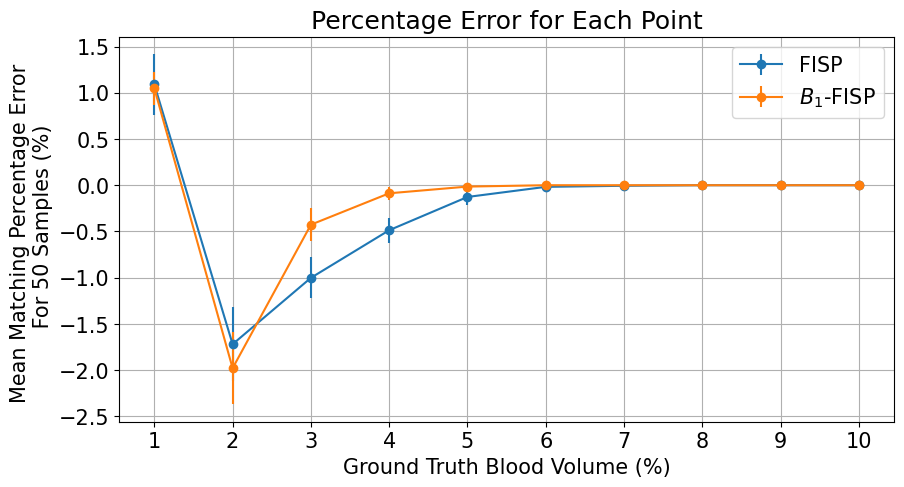

In [70]:
import numpy as np
import matplotlib.pyplot as plt

# Example ground truth array
ground_truths = percArray/10


# Ensure the arrays have the same number of rows
assert ground_truths.shape[0] == percmean_matched_values.shape[0], "Ground truth and test values must have the same number of rows"

# Reshape ground_truths to match the shape of percmean_matched_values
ground_truths = ground_truths[:, np.newaxis]

# Calculate the percentage error for each element
FISP_percentage_errors = ((percmean_matched_values - ground_truths) / ground_truths) * 100
FISPB1_percentage_errors = ((FISPB1percmean_matched_values - ground_truths)/ground_truths) * 100


# Calculate the mean percentage error for each column
FISP_mean_percentage_error = np.mean(FISP_percentage_errors, axis=0)

print("Mean Percentage Error for each column:", FISP_mean_percentage_error)

# Plot the percentage error for each of the 10 points
plt.figure(figsize=(10, 5))
plt.errorbar(ground_truths, FISP_percentage_errors[:, 1],yerr=percmean_iqr_values[:, 1], label='FISP', marker='o')
plt.errorbar(ground_truths, FISPB1_percentage_errors[:,1], yerr=FISPB1percmean_iqr_values[:, 1], label='$B_1$-FISP', marker='o')
plt.xlabel('Ground Truth Blood Volume (%)')
plt.ylabel('Mean Matching Percentage Error \n For 50 Samples (%)')
plt.title('Percentage Error for Each Point')
plt.legend()
plt.xticks([1,2,3,4,5,6,7,8,9,10])
plt.grid(True)

plt.show()

In [ ]:
percmean_iqr_values


array([[0.        , 0.32687831],
       [0.        , 0.39873016],
       [0.        , 0.22253968],
       [0.        , 0.13312169],
       [0.        , 0.0815873 ],
       [0.        , 0.04486772],
       [0.        , 0.01703704],
       [0.        , 0.0042328 ],
       [0.        , 0.00126984],
       [0.        , 0.        ]])

In [ ]:
def calculate_PME(ground_truths, test_values):
    test_values = np.squeeze(test_values)
    ground_truths = np.array(ground_truths)
    # Ensure the arrays have the same shape
    assert ground_truths.shape[0] == test_values.shape[0], "Ground truth and test values must have the same number of rows"
    # Reshape ground_truths to match the shape of resmean_matched_values
    ground_truths = ground_truths[:, np.newaxis]

    # Calculate the percentage error for each element
    percentage_errors = (np.abs((test_values - ground_truths)) / ground_truths) * 100

    # Calculate the mean percentage error
    mean_percentage_error = np.mean(percentage_errors, axis=0)

    print("Mean Percentage Error:", mean_percentage_error)

    return mean_percentage_error




In [ ]:
print('T1t: clean, noise')
discard = calculate_PME(t1tArray, t1tmean_matched_values)
print('T1b: clean, noise')
discard = calculate_PME(t1bArray, t1bmean_matched_values)
print('T2t: clean, noise')
discard = calculate_PME(t2tArray, t2tmean_matched_values)
print('T2b: clean, noise')
discard = calculate_PME(t2bArray, t2bmean_matched_values)
print('perc: clean, noise')
discard = calculate_PME(percArray/10, percmean_matched_values)
print('res: clean, noise')
discard = calculate_PME(resArray, resmean_matched_values)
print('B1: clean, noise')
discard = calculate_PME(multiArray/100, multmean_matched_values)

T1t: clean, noise
Mean Percentage Error: [0. 0.]
T1b: clean, noise
Mean Percentage Error: [0.        0.6726619]
T2t: clean, noise
Mean Percentage Error: [0.         0.45258336]
T2b: clean, noise
Mean Percentage Error: [0.         7.23017833]
perc: clean, noise
Mean Percentage Error: [0.         0.44487276]
res: clean, noise
Mean Percentage Error: [0.         3.51548399]
B1: clean, noise
Mean Percentage Error: [1.98108365e-11 1.98108365e-11]


# SPGRE PLOTTING AND STATS

In [71]:
''' -----------------------------READ IN SPGRE--------------------------------- '''
#empty arrays 
array_mean = np.zeros((x1,x2,x3,x4,x5,5,noise)) # (T1t, T1b, res, perc, multi, dims, noise)
array_err = np.zeros((x1,x2,x3,x4,x5,5,noise))
files = []

if dimensionality == 5:
    mean_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,noise]) # vb
    std_rep_array_blood = np.zeros([x1,x2,x3,x4,x5,noise])
    mean_rep_array_res = np.zeros([x1,x2,x3,x4,x5,noise]) # tau
    std_rep_array_res = np.zeros([x1,x2,x3,x4,x5,noise])

mean_rep_array_blood = np.zeros([x3,x4,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_blood = np.zeros([x3,x4,noise])
mean_rep_array_res = np.zeros([x3,x4,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_res = np.zeros([x3,x4,noise])
mean_rep_array_t1b = np.zeros([x3,x4,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1b = np.zeros([x3,x4,noise])
mean_rep_array_t1t = np.zeros([x3,x4,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_t1t = np.zeros([x3,x4,noise])
mean_rep_array_b1 = np.zeros([x3,x4,noise]) #x1,x2 and x5 removed as they were singular dimensions
std_rep_array_b1 = np.zeros([x3,x4,noise])
mean_rep_array_t2b = np.zeros([x3,x4,noise])
std_rep_array_t2b = np.zeros([x3,x4,noise])
mean_rep_array_t2t = np.zeros([x3,x4,noise])
std_rep_array_t2t = np.zeros([x3,x4,noise])

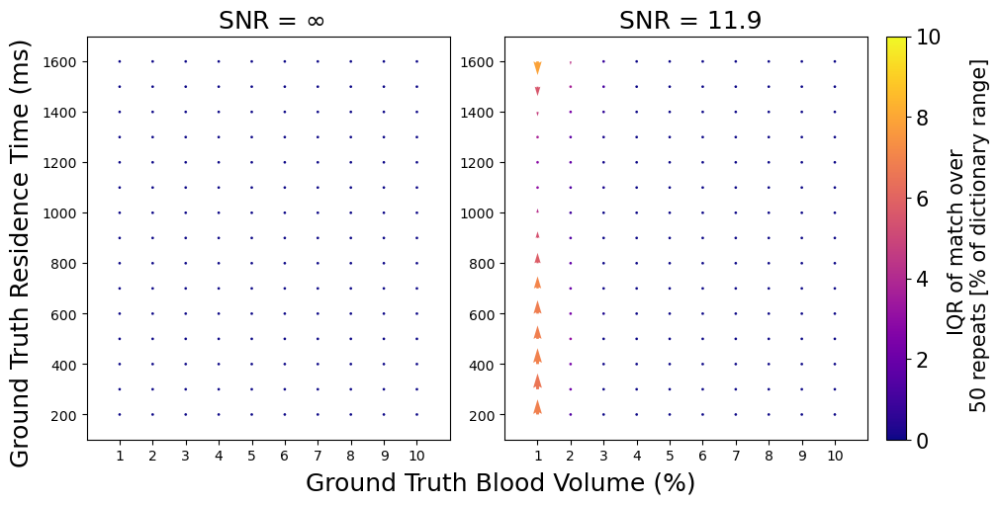

In [74]:
import glob
import os
import numpy as np
import itertools
import matplotlib.pyplot as plt

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_SPGRE_matching'
# Creating grid of residence time and blood volume values
X = np.arange(1, 11, 1)
Y = np.arange(200, 1700, 100)
#X, Y = np.meshgrid(xx, yy)

permutations = list(itertools.product(X, Y))

noi = 2

noise_plot = 0.196

#Arrow specifics
wid = 0.008
sca = 5

# Reset to default font
plt.rcdefaults()

fig, ax = plt.subplots(1, 2, constrained_layout=True)
fig.set_size_inches(10, 5, forward=True)
plt.rcParams.update({'font.size': 15})
plt.rcParams['xtick.labelsize'] = 15
plt.rcParams['ytick.labelsize'] = 15
ax[0].set_ylim([100, 1700])
ax[0].set_xlim([0, 11])
ax[0].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[0].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks
ax[1].set_ylim([100, 1700])
ax[1].set_xlim([0, 11])
ax[1].set_xticks(np.arange(1, 11, 1))  # Set x-ticks at intervals of 200 up to 1000
ax[1].set_xticklabels(np.arange(1, 11, 1))  # Set x-tick labels to match the x-ticks

fig.supylabel('Ground Truth Residence Time (ms)')
fig.supxlabel('Ground Truth Blood Volume (%)')

#mean_match = np.zeros(X.shape + (noi,))
#iqr_match = np.zeros(X.shape + (noi,))
for perm in permutations:
    perc = perm[0]
    res = perm[1]
    #print(f"X = {perc}, Y = {res}")
    # in the folder, find all files that match the current search for vb and residence time
    # Construct the search pattern
    search_pattern = f"{base_folder}/*_*_{res}_{int(perc*10)}_*_pc.npy"

    # Find all files that match the search pattern
    matching_files = glob.glob(search_pattern)
    num_permutations = len(matching_files)
    matched_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    iqr_values_all_files = np.zeros((num_permutations, 2, noi))  # 2 is num of parameters
    file_c = 0
    for file in matching_files:
        current_match = np.load(file)
        matched_values = current_match[0, :, 2:4]  # select the match to the query (res time, bv are at 4 and 5)
        iqr_values = current_match[1, :, 2:4]
        matched_values_all_files[file_c, :, :] = matched_values
        iqr_values_all_files[file_c, :, :] = iqr_values
        file_c += 1
    mean_matched_values = np.mean(matched_values_all_files, axis=0)
    mean_iqr_values = np.mean(iqr_values_all_files, axis=0)


    # make quiver plot
    for n in range(noi):
        # Find the nearest value in the array
        #u_nearest_value = min(X, key=lambda x: abs(x - np.rint(mean_matched_values[n, 1])))
        #v_nearest_value = min(Y, key=lambda x: abs(x - np.rint(mean_matched_values[n, 0])))
        u = np.rint(mean_matched_values[n, 1]) - perc  # bv
        v = np.rint(mean_matched_values[n, 0]) -res  # tau
        u_iqr = mean_iqr_values[n, 1]
        v_iqr = mean_iqr_values[n, 0]

        color = (v_iqr / 1500 + u_iqr / 10) / 2 * 100

        Q = ax[n].quiver(perc, res, u, v, color, width=wid, angles='xy',
                         scale_units='xy', scale=1, cmap='plasma')
        Q.set_clim(0, 10)

        if n == 1:
            ax[n].set_title(' SNR = ' + str(11.9))
        else:
            ax[n].set_title(r' SNR = $\infty$')

cbar = plt.colorbar(Q, label='IQR of match over \n 50 repeats [% of dictionary range]')
plt.show()
    

In [65]:
test_match = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_SPGRE_matching/1000_1500_200_10_0.9_pc.npy'
spgre_fipri_match= np.load(test_match)
spgre_fipri_match.shape

(2, 2, 5)

# Error Of Each Parameter Match at Each Noise Level SPGRE

In [85]:
import numpy as np
import glob

def parameter_mean_iqr(groundTruths, file_query, noi, param_pos):
    # param_pos: 0 = T1t, 1 = T1b, 2 = res, 3 = bv, 4 = B1
    allmean_values = np.zeros((np.shape(groundTruths)[0], noi))
    alliqr_values = np.zeros((np.shape(groundTruths)[0], noi))
    print('Ground Truths:' + str(groundTruths))

    param = 0
    for value in groundTruths:
        # Construct the search pattern
        search_pattern = file_query.format(value)

        # Find all files that match the search pattern
        matching_files = glob.glob(search_pattern)
        num_files= len(matching_files)
        matched_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        iqr_values_all_files = np.zeros((num_files, noi))  # Adjusted shape
        file_c = 0
        for file in matching_files:
            current_match = np.load(file)
            matched_values = current_match[0, :, param_pos]  # select the match to the query
            iqr_values = current_match[1, :, param_pos]
            matched_values_all_files[file_c, :] = matched_values
            iqr_values_all_files[file_c, :] = iqr_values
            file_c += 1

        mean_matched_values = np.mean(matched_values_all_files, axis=0)
        mean_iqr_values = np.mean(iqr_values_all_files, axis=0)
        allmean_values[param, :] = mean_matched_values
        alliqr_values[param, :] = mean_iqr_values

        param += 1
    return allmean_values, alliqr_values


In [77]:
percfile_query = base_folder+"/*_*_*_{}_*_pc.npy"
SPGREpercmean_matched_values, SPGREpercmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 3)
SPGREpercmean_matched_values

Ground Truths:[ 10  20  30  40  50  60  70  80  90 100]


array([[ 1.        ,  1.        ],
       [ 2.        ,  1.99925926],
       [ 3.        ,  3.        ],
       [ 4.        ,  4.        ],
       [ 5.        ,  5.        ],
       [ 6.        ,  6.        ],
       [ 7.        ,  7.        ],
       [ 8.        ,  8.        ],
       [ 9.        ,  9.        ],
       [10.        , 10.        ]])

Mean Percentage Error for each column: [ 0.         -0.22688335]


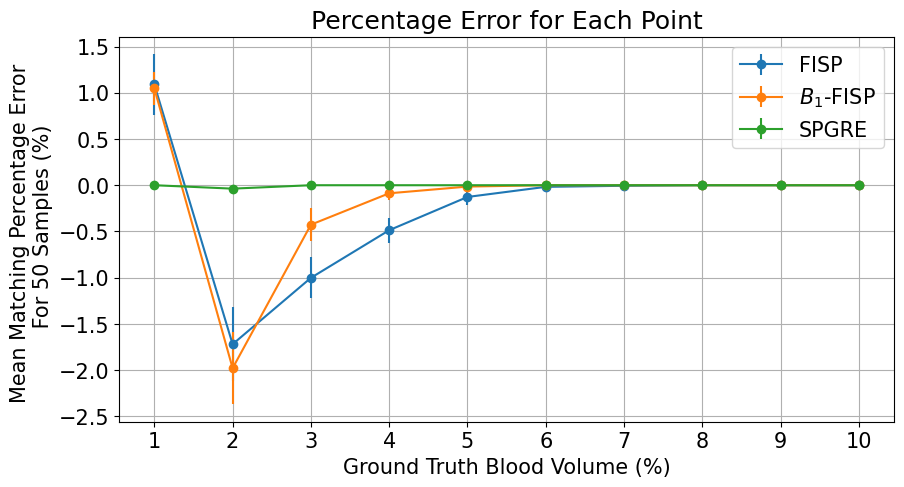

In [78]:
import numpy as np
import matplotlib.pyplot as plt

# Example ground truth array
ground_truths = percArray/10


# Ensure the arrays have the same number of rows
assert ground_truths.shape[0] == percmean_matched_values.shape[0], "Ground truth and test values must have the same number of rows"

# Reshape ground_truths to match the shape of percmean_matched_values
ground_truths = ground_truths[:, np.newaxis]

# Calculate the percentage error for each element
FISP_percentage_errors = ((percmean_matched_values - ground_truths) / ground_truths) * 100
FISPB1_percentage_errors = ((FISPB1percmean_matched_values - ground_truths)/ground_truths) * 100
SPGRE_percentage_errors = ((SPGREpercmean_matched_values - ground_truths)/ground_truths) * 100

# Calculate the mean percentage error for each column
FISP_mean_percentage_error = np.mean(FISP_percentage_errors, axis=0)

print("Mean Percentage Error for each column:", FISP_mean_percentage_error)

# Plot the percentage error for each of the 10 points
plt.figure(figsize=(10, 5))
plt.errorbar(ground_truths, FISP_percentage_errors[:, 1],yerr=percmean_iqr_values[:, 1], label='FISP', marker='o')
plt.errorbar(ground_truths, FISPB1_percentage_errors[:,1], yerr=FISPB1percmean_iqr_values[:, 1], label='$B_1$-FISP', marker='o')
plt.errorbar(ground_truths, SPGRE_percentage_errors[:,1], yerr=SPGREpercmean_iqr_values[:, 1], label='SPGRE', marker='o')
plt.xlabel('Ground Truth Blood Volume (%)')
plt.ylabel('Mean Matching Percentage Error \n For 50 Samples (%)')
plt.title('Percentage Error for Each Point')
plt.legend()
plt.xticks([1,2,3,4,5,6,7,8,9,10])
plt.grid(True)

plt.show()

In [79]:
SPGREpercmean_iqr_values

array([[0.        , 0.01925926],
       [0.        , 0.04296296],
       [0.        , 0.01333333],
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ],
       [0.        , 0.        ]])

In [75]:
import glob
import os
import numpy as np
import itertools

base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_SPGRE_matching'

# ground truth parameter values

resArray = np.arange(200,1700,100) #range(200,1700,107) #range(200,1700,70) 
# percentage blood volume (perc) UNIT: %
percArray = np.arange(10,110,10) #REMEMBER IT WILL BE DIVIDED BY 10 110
#T1 of tissue compartment (t1t) UNIT: ms
t1tArray = np.arange(1000,2200,200) #range(700,1700,69) 
#T1 of blood compartment (t1b) UNIT: ms
t1bArray = np.arange(1500,2100,200) #range(1540,1940,27) 
# multiplication factor for the B1 value (multi)
multiArray = np.arange(80, 130, 10) #100
# T2 of tissue compartment UNIT: ms

noi = 2

In [90]:
base_folder = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_SPGRE_matching'
resfile_query = base_folder+"/*_*_{}_*_*_pc.npy"
resmean_matched_values, resmean_iqr_values = parameter_mean_iqr(resArray, resfile_query, noi, param_pos = 2)

t1tfile_query = base_folder+"/{}_*_*_*_*_pc.npy"
t1tmean_matched_values, t1tmean_iqr_values = parameter_mean_iqr(t1tArray, t1tfile_query, noi, param_pos = 0)

t1bfile_query = base_folder+"/*_{}_*_*_*_pc.npy"
t1bmean_matched_values, t1bmean_iqr_values = parameter_mean_iqr(t1bArray, t1bfile_query, noi, param_pos = 1)

percfile_query = base_folder+"/*_*_*_{}_*_pc.npy"
percmean_matched_values, percmean_iqr_values = parameter_mean_iqr(percArray, percfile_query, noi, param_pos = 3)

multfile_query = base_folder+"/*_*_*_*_{}_pc.npy"
multmean_matched_values, multmean_iqr_values = parameter_mean_iqr(multiArray/100, multfile_query, noi, param_pos = 4)

Ground Truths:[ 200  300  400  500  600  700  800  900 1000 1100 1200 1300 1400 1500
 1600]
Ground Truths:[1000 1200 1400 1600 1800 2000]
Ground Truths:[1500 1700 1900]
Ground Truths:[ 10  20  30  40  50  60  70  80  90 100]
Ground Truths:[0.8 0.9 1.  1.1 1.2]


In [91]:
print('T1t: clean, noise')
discard = calculate_PME(t1tArray, t1tmean_matched_values)
print('T1b: clean, noise')
discard = calculate_PME(t1bArray, t1bmean_matched_values)
print('perc: clean, noise')
discard = calculate_PME(percArray/10, percmean_matched_values)
print('res: clean, noise')
discard = calculate_PME(resArray, resmean_matched_values)
print('B1: clean, noise')
discard = calculate_PME(multiArray/100, multmean_matched_values)

T1t: clean, noise
Mean Percentage Error: [0. 0.]
T1b: clean, noise
Mean Percentage Error: [0.         0.09237167]
perc: clean, noise
Mean Percentage Error: [0.        0.0037037]
res: clean, noise
Mean Percentage Error: [0.         0.76634489]
B1: clean, noise
Mean Percentage Error: [3.30605352e-12 3.30605352e-12]


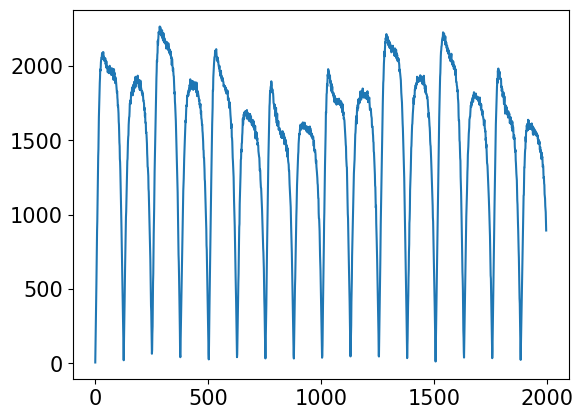

In [ ]:
test_file = '/Users/ela/Documents/PhD/code/MRFSGRE_BBB/simulationData/noisy_upgrade_SPGRE/echo_1000_1500_200_1.0_0.8_50.npy'
spgre_fipri = np.load(test_file)
plt.plot(spgre_fipri[1:,1,1])
